In [1]:
import cv2 as cv
import numpy as np
import random
import torch
import torch.nn as nn
from torch.autograd import Variable
from torchvision import datasets,transforms
import torch.nn.functional as F
from torchvision import models
import time
import os
%matplotlib inline
from torch.utils.checkpoint import checkpoint_sequential
import matplotlib.pyplot as plt
from PIL import Image, ImageFilter, ImageDraw, ImageStat

In [2]:
pic_dir = './dataset/'
file_name = pic_dir + '藏A2222B.png'
char_lst = ['0', '1', '2', '3', '4', '5', '6', '7', '8', '9', 'A', 'B', 'C', 'D', 'E', 'F', 'G', 'H', 'I', 'J', 'K', 'L', 'M', 'N', 'O', 'P', 'Q', 'R', 'S', 'T', 'U', 'V', 'W', 'X', 'Y', 'Z']
province_lst = ['赣', '辽', '吉', '黑', '蒙', '冀', '晋', '陕', '宁', '鲁', '皖', '苏', '浙', '渝', '沪', '津', '京', '川', '贵', '鄂', '桂', '闽', '青', '琼', '湘', '新', '豫', '粤', '云', '藏']

In [3]:
args  = {
    'embedding_feature': 50,
    'vocab_size': 66,
    'num_gru_layer': 2,
    'gru_hidden_feature': 7,
    'gpu': None,
    'epochs': 500,
    'lr': 0.001,
    'batch_size': 1,
    'workers': 4,
    'seed': time.time(),
    'print_freq': 2,
#     'pre':None,
    'pre': './best_model/CPRNet_model_best.pth.tar',
    'test_freq': 5
}

In [4]:
#utils.py
def save_net(fname, net):
    with h5py.File(fname, 'w') as h5f:
        for k, v in net.state_dict().items():
            h5f.create_dataset(k, data=v.cpu().numpy())
def load_net(fname, net):
    with h5py.File(fname, 'r') as h5f:
        for k, v in net.state_dict().items():        
            param = torch.from_numpy(np.asarray(h5f[k]))         
            v.copy_(param)
            
def save_checkpoint(state, is_best, task_id, filename='checkpoint.pth.tar'):
    if is_best:
        torch.save(state, './best_model/' + task_id + '_model_best.pth.tar')
        
def adjust_learning_rate(optimizer, epoch):
    """Sets the learning rate to the initial LR decayed by 10 every 10 epochs"""
    lr = args['lr'] * (0.1 ** (epoch // 50))
    for param_group in optimizer.param_groups:
        param_group['lr'] = lr

class AverageMeter(object):
    """Computes and stores the average and current value"""
    def __init__(self):
        self.reset()

    def reset(self):
        self.val = 0
        self.avg = 0
        self.sum = 0
        self.count = 0

    def update(self, val, n=1):
        self.val = val
        self.sum += val * n
        self.count += n
        self.avg = self.sum / self.count  

In [5]:
# model.py
class CPR_Net(nn.Module):
    def __init__(self):
        super(CPR_Net, self).__init__()
        self.gru = nn.GRU(440, args['gru_hidden_feature'], args['num_gru_layer'], batch_first=True, bidirectional=False)
        self.pro_fc = nn.Sequential(
            nn.BatchNorm1d(140),
            nn.Linear(140, len(province_lst)),
            nn.ReLU(inplace=True),
            nn.Linear(len(province_lst), len(province_lst)),
        )
        self.lic_fc1 = nn.Sequential(
            nn.BatchNorm1d(140),
            nn.Linear(140, len(char_lst)),
            nn.ReLU(inplace=True),
            nn.Linear(len(char_lst), len(char_lst)),
        )
        self.lic_fc2 = nn.Sequential(
            nn.BatchNorm1d(140),
            nn.Linear(140, len(char_lst)),
            nn.ReLU(inplace=True),
            nn.Linear(len(char_lst), len(char_lst)),
        )
        self.lic_fc3 = nn.Sequential(
            nn.BatchNorm1d(140),
            nn.Linear(140, len(char_lst)),
            nn.ReLU(inplace=True),
            nn.Linear(len(char_lst), len(char_lst)),
        )
        self.lic_fc4 = nn.Sequential(
            nn.BatchNorm1d(140),
            nn.Linear(140, len(char_lst)),
            nn.ReLU(inplace=True),
            nn.Linear(len(char_lst), len(char_lst)),
        )
        self.lic_fc5 = nn.Sequential(
            nn.BatchNorm1d(140),
            nn.Linear(140, len(char_lst)),
            nn.ReLU(inplace=True),
            nn.Linear(len(char_lst), len(char_lst)),
        )
        self.lic_fc6 = nn.Sequential(
            nn.BatchNorm1d(140),
            nn.Linear(140, len(char_lst)),
            nn.ReLU(inplace=True),
            nn.Linear(len(char_lst), len(char_lst)),
        )
        
    def forward(self, img):
        img = img.squeeze(1)
        gru_feature, _ = self.gru(img)
        raw_province_feature = gru_feature[:,:,0]
        raw_license_feature = gru_feature[:,:,1:]
        province_feature = F.softmax(self.pro_fc(raw_province_feature), dim=1)
        
        license_feature = F.softmax(self.lic_fc1(raw_license_feature[:,:,0]), dim=1).unsqueeze(1)
        license_feature = torch.cat((license_feature, F.softmax(self.lic_fc2(raw_license_feature[:,:,1]), dim=1).unsqueeze(1)), 1)
        license_feature = torch.cat((license_feature, F.softmax(self.lic_fc3(raw_license_feature[:,:,2]), dim=1).unsqueeze(1)), 1)
        license_feature = torch.cat((license_feature, F.softmax(self.lic_fc4(raw_license_feature[:,:,3]), dim=1).unsqueeze(1)), 1)
        license_feature = torch.cat((license_feature, F.softmax(self.lic_fc5(raw_license_feature[:,:,4]), dim=1).unsqueeze(1)), 1)
        license_feature = torch.cat((license_feature, F.softmax(self.lic_fc6(raw_license_feature[:,:,5]), dim=1).unsqueeze(1)), 1)
        
        return province_feature, license_feature

In [6]:
model = CPR_Net()

if args['pre']:
    if os.path.isfile(args['pre']):
        print("=> loading checkpoint '{}'".format(args['pre']))
        checkpoint = torch.load(args['pre'])
        args['start_epoch'] = checkpoint['epoch']
        best_acc = checkpoint['best_prec1']
        model.load_state_dict(checkpoint['state_dict'])
#         optimizer.load_state_dict(checkpoint['optimizer'])
        print("=> loaded checkpoint '{}' (epoch {})"
                .format(args['pre'], checkpoint['epoch']))
    else:
        print("=> no checkpoint found at '{}'".format(args['pre']))

=> loading checkpoint './best_model/CPRNet_model_best.pth.tar'
=> loaded checkpoint './best_model/CPRNet_model_best.pth.tar' (epoch 250)


**************************************************
Target:  津A56789


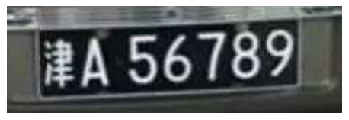

Result:  川A56989
**************************************************
Target:  云F66666


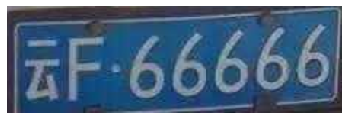

Result:  苏F66668
**************************************************
Target:  皖H01356


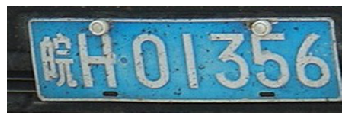

Result:  辽A01056
**************************************************
Target:  闽J12345


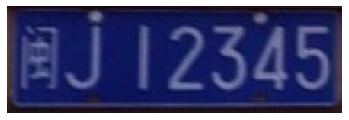

Result:  皖B12376
**************************************************
Target:  川O71775


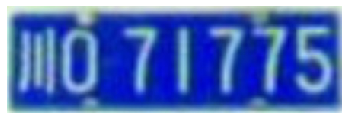

Result:  粤A71188
**************************************************
Target:  鄂A85044


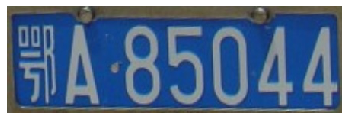

Result:  鄂A88025
**************************************************
Target:  皖AH0002


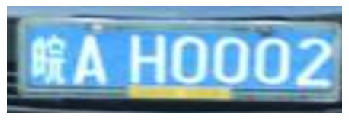

Result:  辽AH0208
**************************************************
Target:  陕K13333


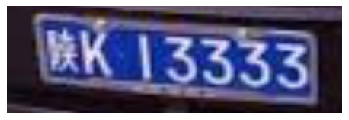

Result:  陕A15230
**************************************************
Target:  苏A88888


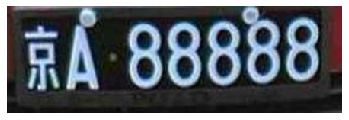

Result:  苏A88887
**************************************************
Target:  苏NG5508


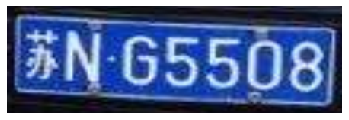

Result:  苏B02505
**************************************************
Target:  辽B96969


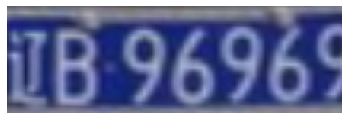

Result:  鄂B06969
**************************************************
Target:  贵EU6003


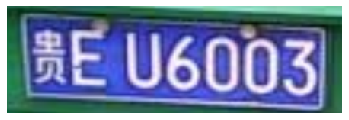

Result:  贵L00009
**************************************************
Target:  沪AZ0518


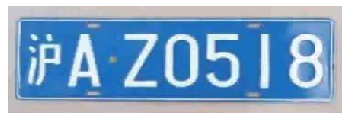

Result:  辽A70588
**************************************************
Target:  豫AG9999


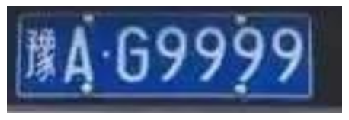

Result:  京A19907
**************************************************
Target:  鄂EZ002K


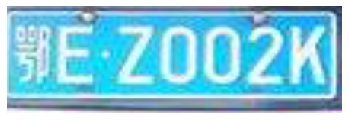

Result:  鄂A90035
**************************************************
Target:  青D11111


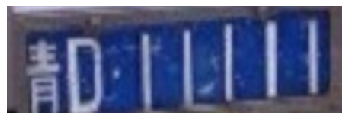

Result:  粤F11188
**************************************************
Target:  藏A2222B


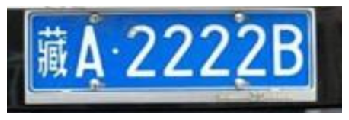

Result:  苏AW2227
**************************************************
Target:  鄂AY8560


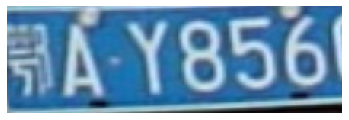

Result:  鄂AZ8062
**************************************************
Target:  青C79888


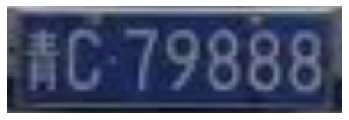

Result:  粤C79888
**************************************************
Target:  湘E88888


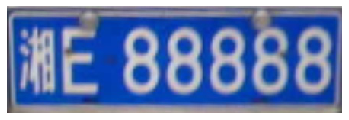

Result:  鄂A88888
**************************************************
Target:  晋C88888


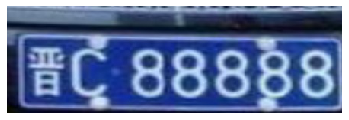

Result:  鄂A88888
**************************************************
Target:  鄂A28076


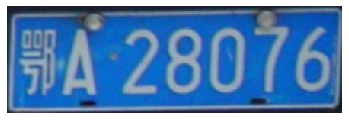

Result:  鄂A88386
**************************************************
Target:  豫GQQ777


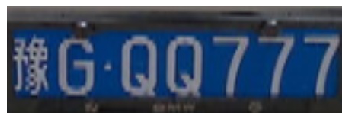

Result:  豫F28791
**************************************************
Target:  川A29922


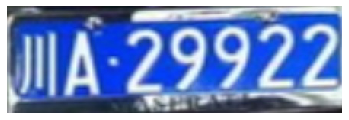

Result:  贵A89995
**************************************************
Target:  赣G12345


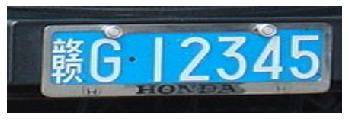

Result:  鄂G12385
**************************************************
Target:  苏A2396V


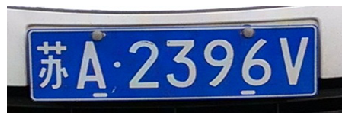

Result:  苏A25968
**************************************************
Target:  川R87979


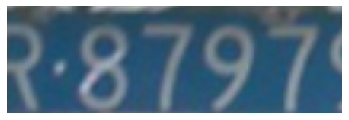

Result:  川A86229
**************************************************
Target:  冀A22222


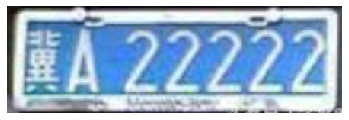

Result:  鲁A28222
**************************************************
Target:  云AMP526


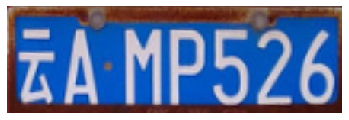

Result:  云AP0226
**************************************************
Target:  青F01806


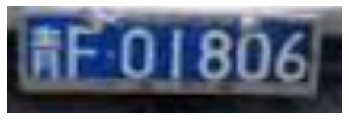

Result:  鄂F01806
**************************************************
Target:  川L99999


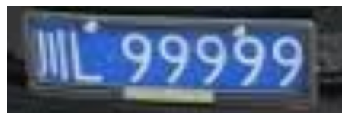

Result:  川B09939
**************************************************
Target:  琼BZ6666


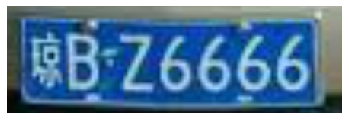

Result:  琼BP6666
**************************************************
Target:  蒙B00005


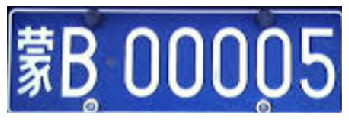

Result:  鄂B00000
**************************************************
Target:  陕000000


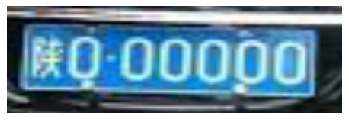

Result:  陕BA0000
**************************************************
Target:  粤A44444


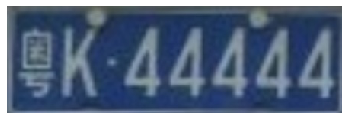

Result:  鄂A42165
**************************************************
Target:  鄂AB8088


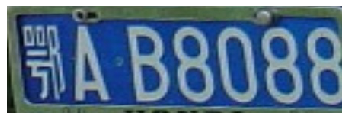

Result:  鄂A48188
**************************************************
Target:  豫MW9635


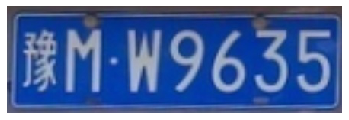

Result:  鄂AW9685
**************************************************
Target:  辽B1036A


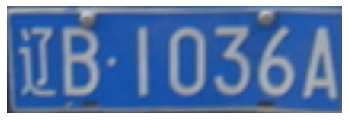

Result:  鲁A20368
**************************************************
Target:  浙J66666


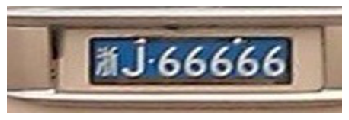

Result:  鄂A86866
**************************************************
Target:  渝A88888


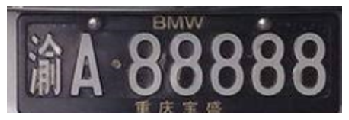

Result:  鄂A88888
**************************************************
Target:  粤BPP153


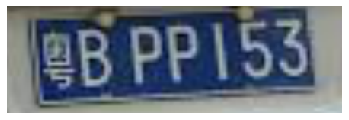

Result:  辽A98888
**************************************************
Target:  鄂H00000


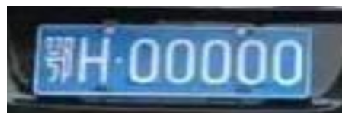

Result:  鄂A00000
**************************************************
Target:  皖A88888


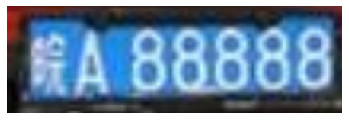

Result:  鄂A88888
**************************************************
Target:  鄂EE2307


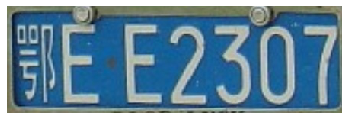

Result:  鄂A09000
**************************************************
Target:  辽B5705D


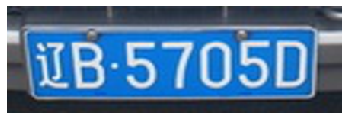

Result:  豫G58059
**************************************************
Target:  渝A44444


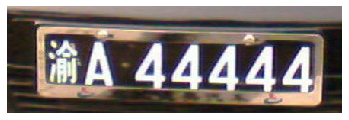

Result:  粤A85188
**************************************************
Target:  贵GA5555


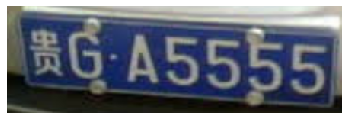

Result:  贵G55585
**************************************************
Target:  津MWF999


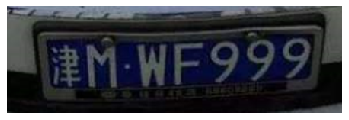

Result:  云AW1991
**************************************************
Target:  豫KUZ277


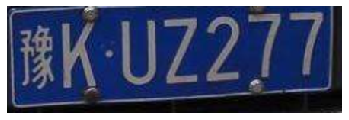

Result:  豫AU1167
**************************************************
Target:  苏JAY888


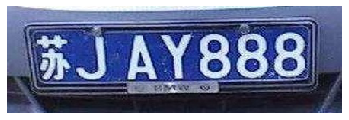

Result:  苏A09888
**************************************************
Target:  京K55555


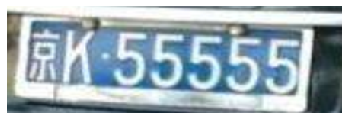

Result:  京B85958
**************************************************
Target:  苏BGN307


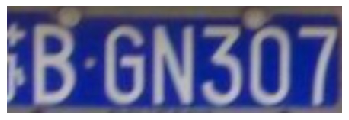

Result:  鄂BS9899
**************************************************
Target:  桂BB6988


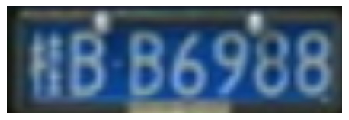

Result:  豫BD6988
**************************************************
Target:  沪KR9888


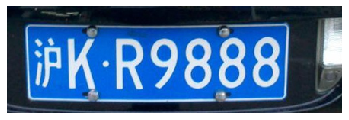

Result:  鄂G08887
**************************************************
Target:  川KB8888


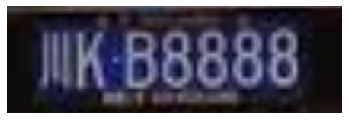

Result:  川A08806
**************************************************
Target:  津GBL777


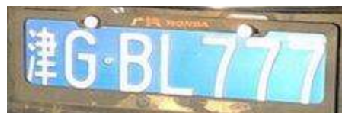

Result:  苏AU0027
**************************************************
Target:  浙F77777


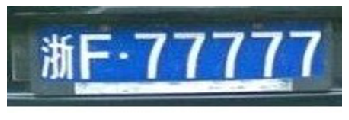

Result:  鲁A72277
**************************************************
Target:  辽B57368


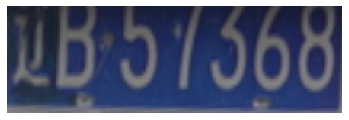

Result:  辽A58768
**************************************************
Target:  赣B99999


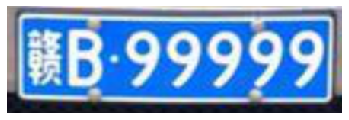

Result:  赣BZ9999
**************************************************
Target:  京QWL663


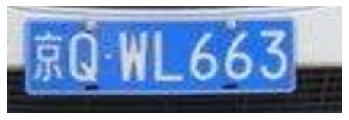

Result:  鲁A96665
**************************************************
Target:  津A11111


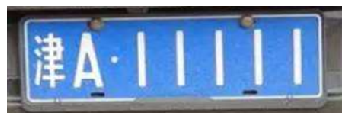

Result:  鄂A91816
**************************************************
Target:  青E04888


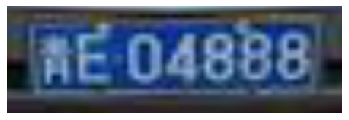

Result:  青B06888
**************************************************
Target:  晋EHS001


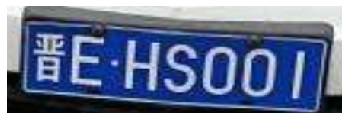

Result:  苏AH5531
**************************************************
Target:  浙GQD555


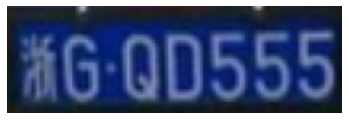

Result:  浙A06858
**************************************************
Target:  琼D77888


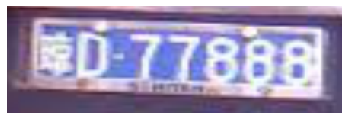

Result:  辽A78888
**************************************************
Target:  京N1CK19


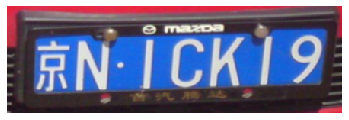

Result:  黑A11918
**************************************************
Target:  吉BR1777


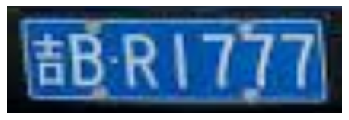

Result:  吉B11377
**************************************************
Target:  蒙L88747


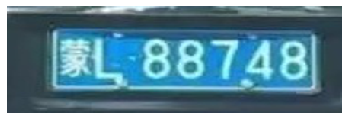

Result:  蒙L88768
**************************************************
Target:  辽D56788


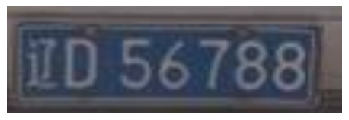

Result:  辽D56788
**************************************************
Target:  陕F00000


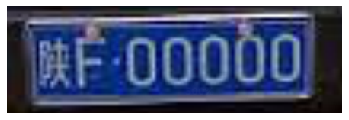

Result:  陕A08000
**************************************************
Target:  蒙M07555


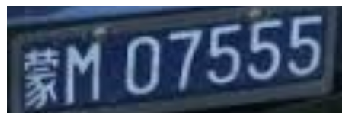

Result:  云A08555
**************************************************
Target:  鄂E89999


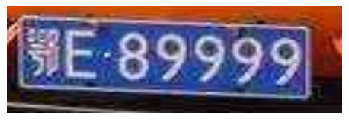

Result:  鄂FA1909
**************************************************
Target:  湘B6N136


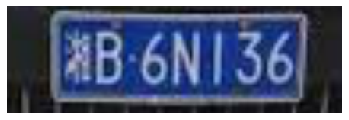

Result:  湘B11186
**************************************************
Target:  藏AAK520


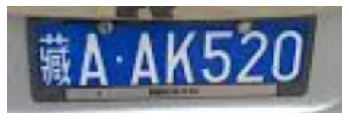

Result:  津A98228
**************************************************
Target:  湘K00001


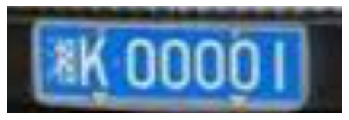

Result:  青B00006
**************************************************
Target:  琼A99999


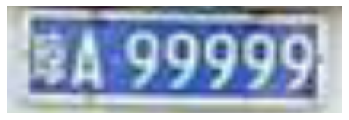

Result:  鄂A99999
**************************************************
Target:  蒙F33333


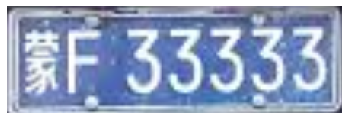

Result:  鄂A26388
**************************************************
Target:  宁AUY960


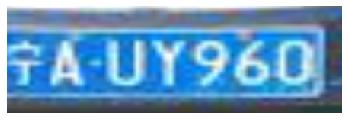

Result:  辽A80966
**************************************************
Target:  贵B55555


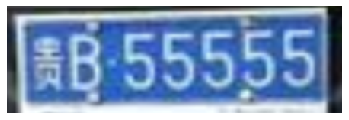

Result:  贵B50000
**************************************************
Target:  浙GZB388


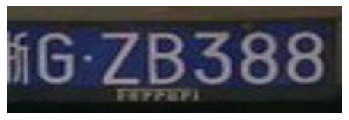

Result:  琼G18188
**************************************************
Target:  川V00000


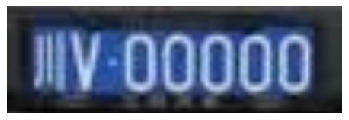

Result:  川A00000
**************************************************
Target:  陕CGC700


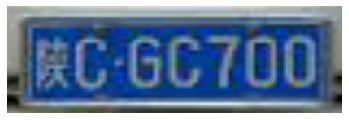

Result:  辽A79188
**************************************************
Target:  浙DP3333


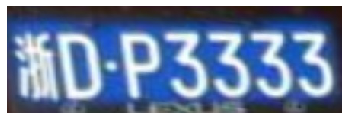

Result:  浙A06531
**************************************************
Target:  宁D22222


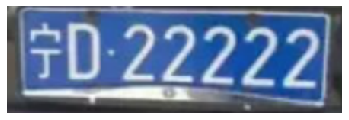

Result:  浙B22222
**************************************************
Target:  苏N00000


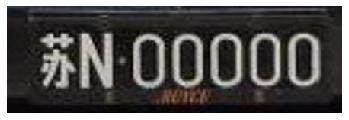

Result:  苏E08188
**************************************************
Target:  鲁A70Q63


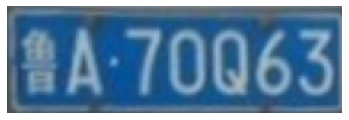

Result:  鲁A70035
**************************************************
Target:  川A88888


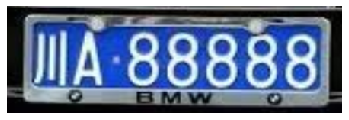

Result:  辽A88888
**************************************************
Target:  鄂AE3456


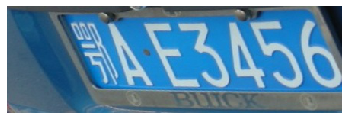

Result:  鄂AV0056
**************************************************
Target:  浙L96060


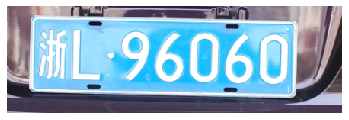

Result:  鲁A96065
**************************************************
Target:  皖A33333


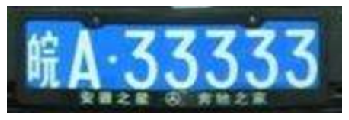

Result:  皖AW8030
**************************************************
Target:  吉BL2222


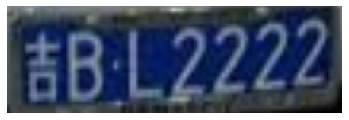

Result:  吉BW2222
**************************************************
Target:  京Q89999


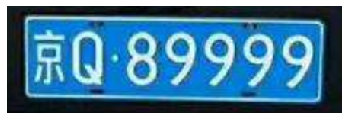

Result:  吉B09999
**************************************************
Target:  辽AJW767


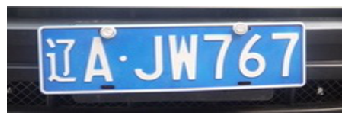

Result:  辽A01807
**************************************************
Target:  鄂AAP378


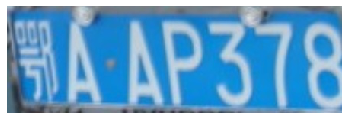

Result:  鄂A80978
**************************************************
Target:  沪A688B8


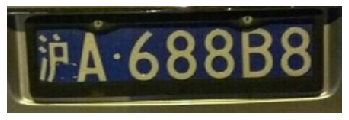

Result:  浙A88888
**************************************************
Target:  川ADN777


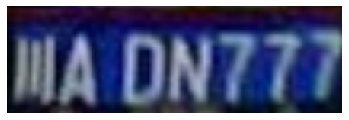

Result:  川A80707
**************************************************
Target:  津DSB250


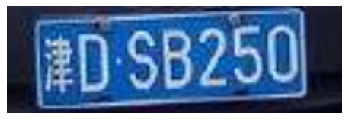

Result:  苏A02800
**************************************************
Target:  冀BW0919


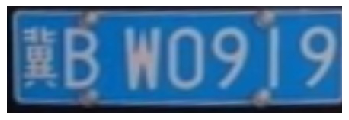

Result:  吉BW0927
**************************************************
Target:  云PQQ360


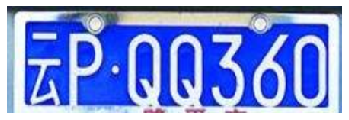

Result:  云A26961
**************************************************
Target:  冀BQQ613


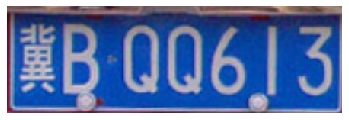

Result:  鄂B80725
**************************************************
Target:  辽P77777


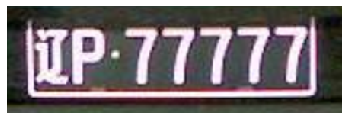

Result:  辽A17377
**************************************************
Target:  浙GZJ021


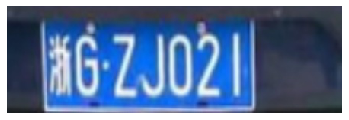

Result:  黑GZ9929
**************************************************
Target:  鄂N88888


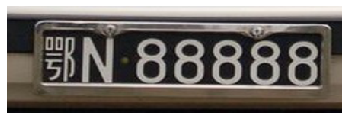

Result:  鄂B88888
**************************************************
Target:  苏BB8888


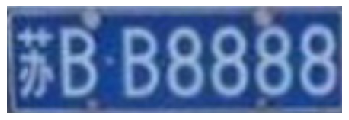

Result:  苏B08080
**************************************************
Target:  冀A2B945


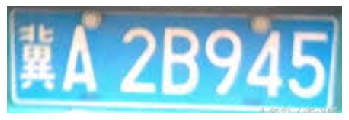

Result:  鄂A70005
**************************************************
Target:  苏D22022


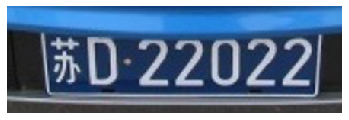

Result:  苏B22022
**************************************************
Target:  青BC2222


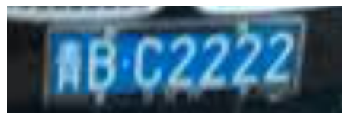

Result:  贵B02022
**************************************************
Target:  吉G10086


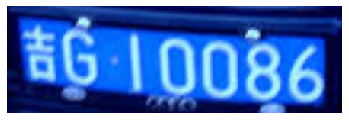

Result:  川B00086
**************************************************
Target:  豫G99999


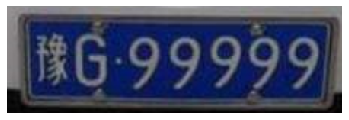

Result:  辽G99998
**************************************************
Target:  皖PT5609


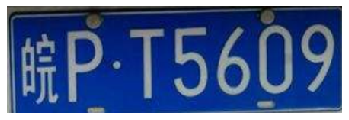

Result:  川A05669
**************************************************
Target:  晋A88888


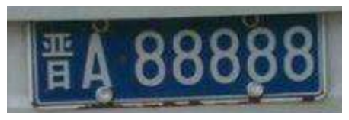

Result:  辽A88888
**************************************************
Target:  鄂AD6765


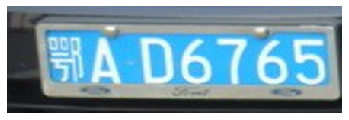

Result:  鄂A88765
**************************************************
Target:  贵E11128


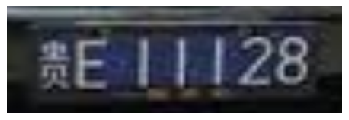

Result:  贵E11128
**************************************************
Target:  川A88888


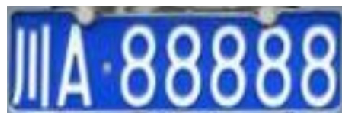

Result:  川A00002
**************************************************
Target:  晋O11111


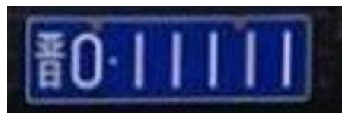

Result:  晋E11116
**************************************************
Target:  陕ADD000


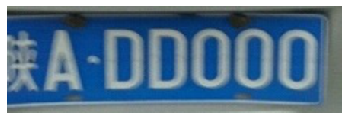

Result:  辽A25270
**************************************************
Target:  辽B48599


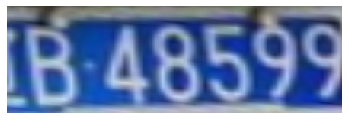

Result:  辽BA8591
**************************************************
Target:  豫JPP777


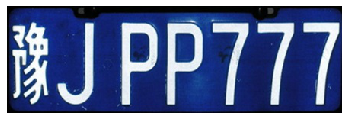

Result:  赣BU9907
**************************************************
Target:  青H01885


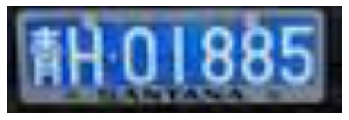

Result:  青B01808
**************************************************
Target:  闽K97777


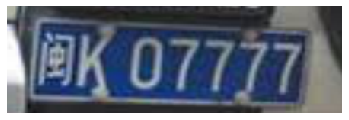

Result:  辽A97888
**************************************************
Target:  贵000000


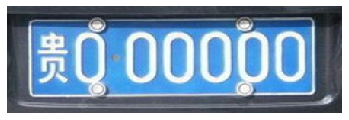

Result:  贵A00000
**************************************************
Target:  沪H88663


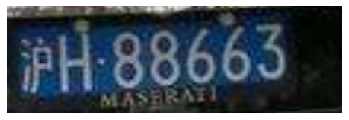

Result:  沪F88866
**************************************************
Target:  豫RA9289


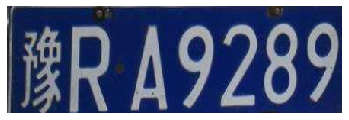

Result:  豫AA1889
**************************************************
Target:  晋B33333


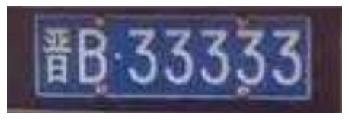

Result:  京BU6236
**************************************************
Target:  云F8888E


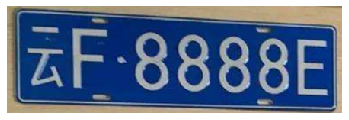

Result:  粤A81888
**************************************************
Target:  鄂AX1415


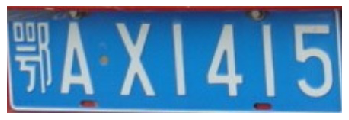

Result:  鄂A78585
**************************************************
Target:  云G33333


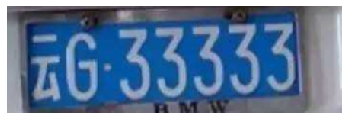

Result:  辽A79398
**************************************************
Target:  吉AG6666


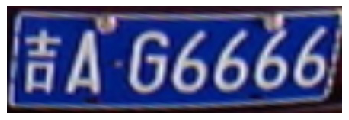

Result:  云AP6666
**************************************************
Target:  晋HT1547


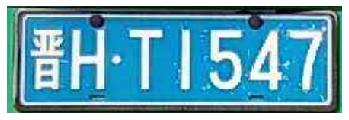

Result:  辽A71588
**************************************************
Target:  鄂AEB506


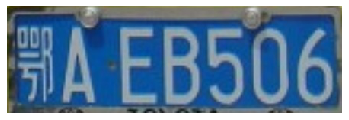

Result:  鄂A08506
**************************************************
Target:  苏GM0000


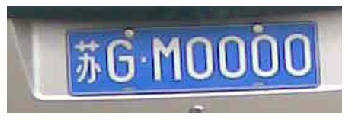

Result:  辽A96899
**************************************************
Target:  京HF5427


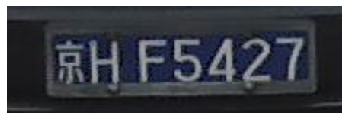

Result:  京A05327
**************************************************
Target:  赣G8V666


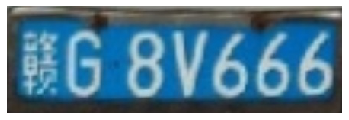

Result:  鲁G82666
**************************************************
Target:  湘E68888


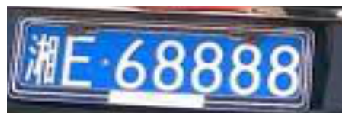

Result:  湘EA8888
**************************************************
Target:  鲁LD9016


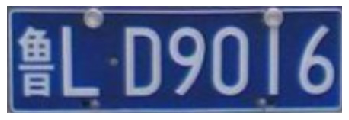

Result:  鄂A09006
**************************************************
Target:  吉B33333


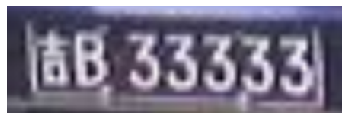

Result:  吉A85237
**************************************************
Target:  晋AV0009


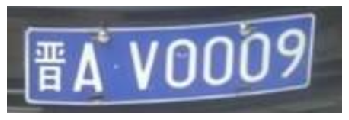

Result:  鄂AV0009
**************************************************
Target:  鄂ACG775


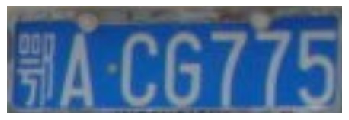

Result:  鄂AC1785
**************************************************
Target:  辽GM2513


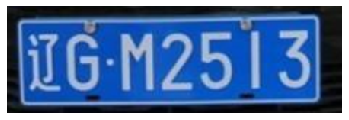

Result:  川A02500
**************************************************
Target:  黑E99999


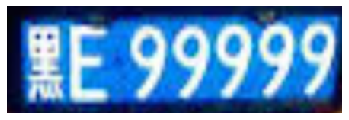

Result:  粤A99999
**************************************************
Target:  辽BX5X55


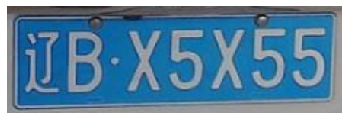

Result:  辽A80585
**************************************************
Target:  粤B0K999


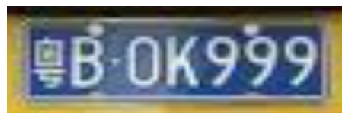

Result:  鄂A59999
**************************************************
Target:  京E55555


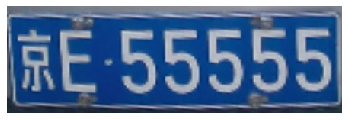

Result:  苏B85585
**************************************************
Target:  鄂AAD198


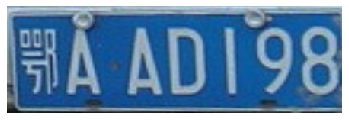

Result:  鄂A99998
**************************************************
Target:  晋F21696


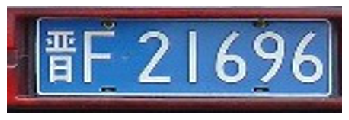

Result:  粤B21898
**************************************************
Target:  云F55555


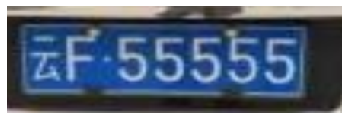

Result:  云FU5555
**************************************************
Target:  鄂E38888


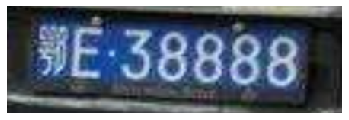

Result:  鄂F58888
**************************************************
Target:  浙B999AA


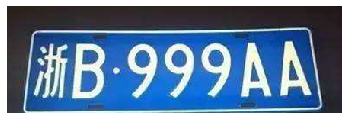

Result:  浙B80978
**************************************************
Target:  辽B2723L


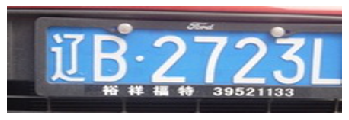

Result:  辽A28231
**************************************************
Target:  云G99999


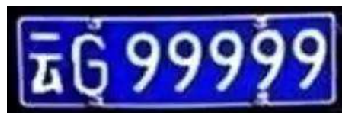

Result:  豫G19999
**************************************************
Target:  蒙A33333


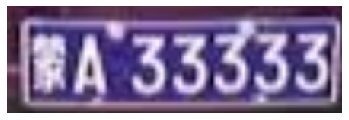

Result:  鄂A16338
**************************************************
Target:  川AT0H69


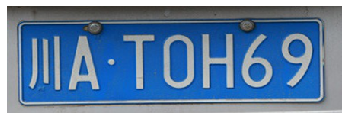

Result:  川AT0066
**************************************************
Target:  闽J66666


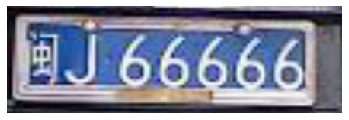

Result:  云A00006
**************************************************
Target:  鲁A969N7


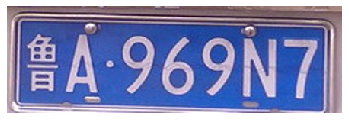

Result:  鲁A96765
**************************************************
Target:  赣A00000


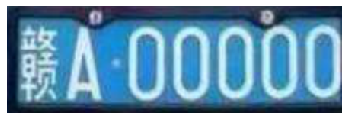

Result:  皖A00000
**************************************************
Target:  赣B99999


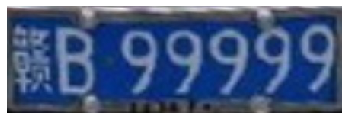

Result:  豫B59999
**************************************************
Target:  浙HB1111


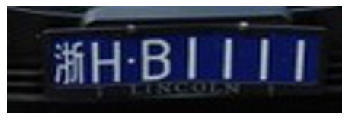

Result:  浙A01111
**************************************************
Target:  苏DER238


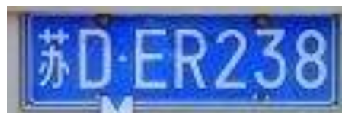

Result:  鄂A88188
**************************************************
Target:  蒙BPK833


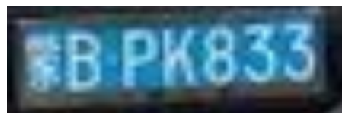

Result:  贵B01800
**************************************************
Target:  京FP1852


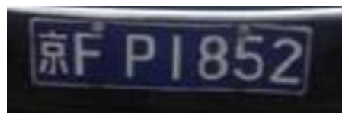

Result:  京FA1852
**************************************************
Target:  鲁LC1336


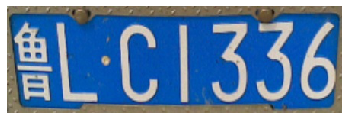

Result:  鲁AC1336
**************************************************
Target:  沪ADW099


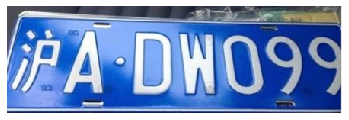

Result:  云AP0081
**************************************************
Target:  辽B5776C


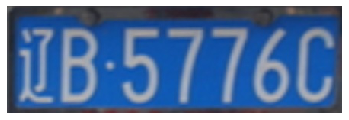

Result:  辽B52762
**************************************************
Target:  豫G00000


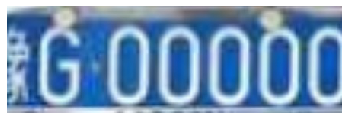

Result:  辽A80058
**************************************************
Target:  蒙A00002


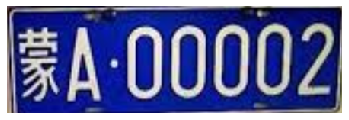

Result:  苏A00002
**************************************************
Target:  闽FA8888


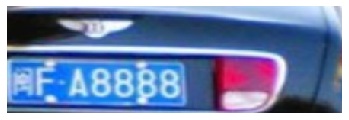

Result:  豫F18888
**************************************************
Target:  津E13581


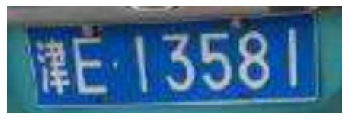

Result:  津AT8580
**************************************************
Target:  蒙BYD600


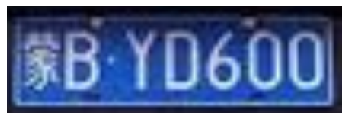

Result:  吉BW0607
**************************************************
Target:  冀A99999


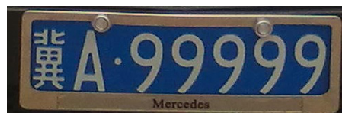

Result:  辽A99998
**************************************************
Target:  琼E88888


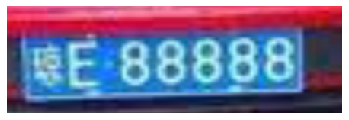

Result:  贵B88808
**************************************************
Target:  浙DC6X81


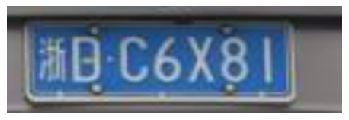

Result:  鄂A76888
**************************************************
Target:  川ASB110


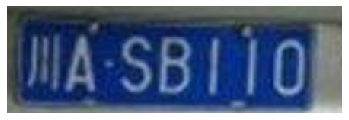

Result:  鄂AS8918
**************************************************
Target:  桂AHQ703


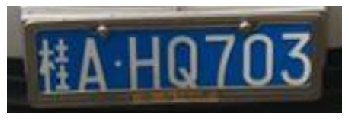

Result:  贵A01702
**************************************************
Target:  贵B88888


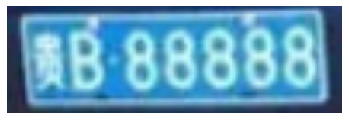

Result:  贵B88808
**************************************************
Target:  粤Y88888


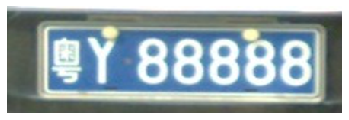

Result:  粤A88988
**************************************************
Target:  鲁HJA444


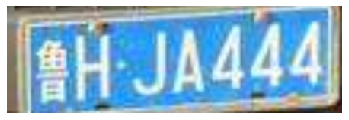

Result:  津A80888
**************************************************
Target:  桂A88888


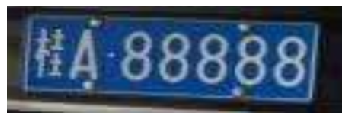

Result:  鄂A08806
**************************************************
Target:  川C66666


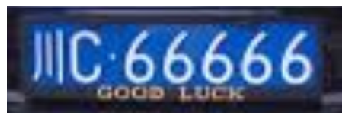

Result:  川A06666
**************************************************
Target:  黑F55555


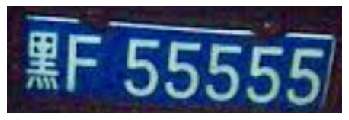

Result:  湘A08586
**************************************************
Target:  晋O00888


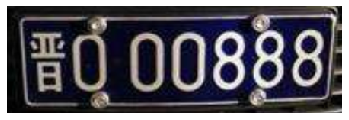

Result:  辽A00888
**************************************************
Target:  贵B22222


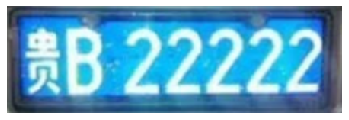

Result:  贵A02222
**************************************************
Target:  辽A09030


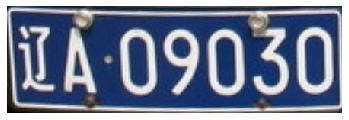

Result:  云A09000
**************************************************
Target:  川A520AV


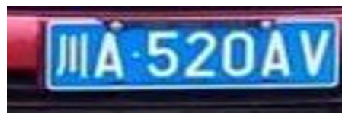

Result:  津A02000
**************************************************
Target:  辽B07559


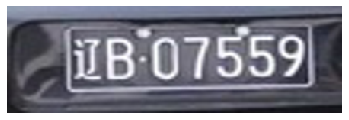

Result:  辽B00002
**************************************************
Target:  青B32352


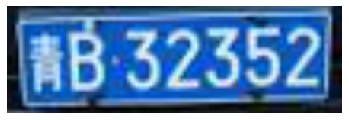

Result:  贵B82357
**************************************************
Target:  鄂AD1257


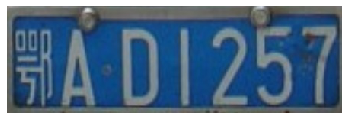

Result:  鄂A01056
**************************************************
Target:  浙K73966


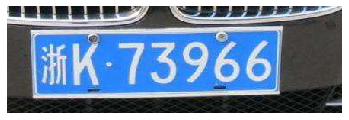

Result:  浙KU0966
**************************************************
Target:  吉A2222B


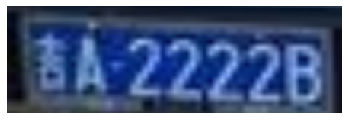

Result:  吉A01888
**************************************************
Target:  川C66666


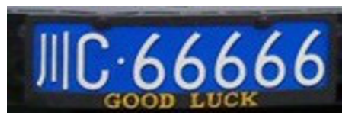

Result:  苏A66666
**************************************************
Target:  藏FA0731


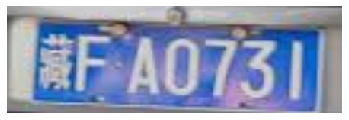

Result:  粤AU0231
**************************************************
Target:  青B88888


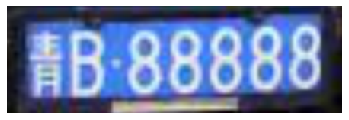

Result:  苏B88888
**************************************************
Target:  桂AA6089


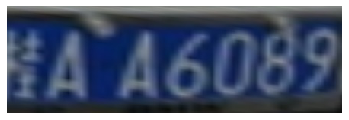

Result:  鲁AA6189
**************************************************
Target:  琼B22222


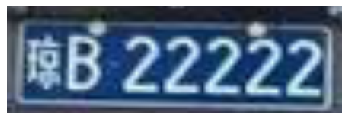

Result:  贵BC2222
**************************************************
Target:  鄂B74110


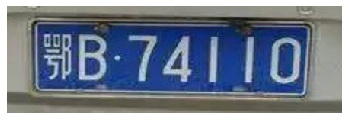

Result:  鄂A76185
**************************************************
Target:  苏A0K007


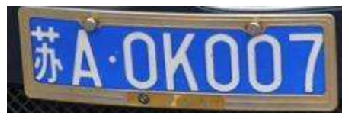

Result:  苏A00007
**************************************************
Target:  鲁L0N510


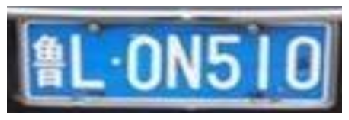

Result:  鲁A90568
**************************************************
Target:  冀B99999


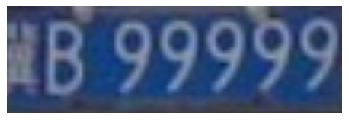

Result:  辽B89996
**************************************************
Target:  京A00006


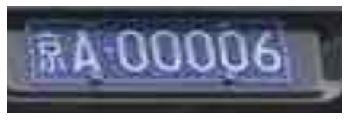

Result:  鄂A80788
**************************************************
Target:  黑B00000


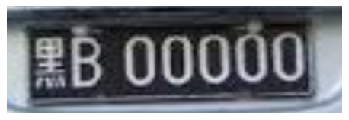

Result:  辽A80088
**************************************************
Target:  闽K11111


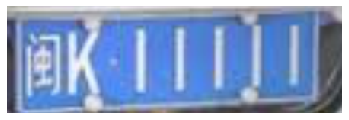

Result:  云A18231
**************************************************
Target:  川F00006


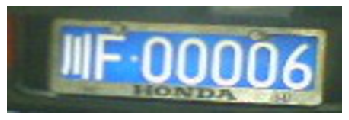

Result:  川A00000
**************************************************
Target:  京A80930


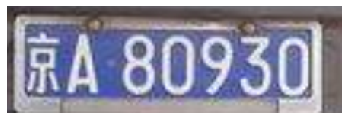

Result:  辽A80038
**************************************************
Target:  津FE8877


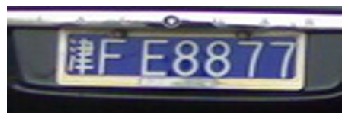

Result:  津B81377
**************************************************
Target:  沪ABA650


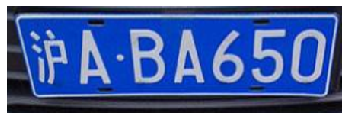

Result:  津A06188
**************************************************
Target:  晋AF8888


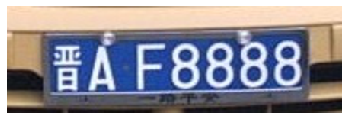

Result:  苏A98888
**************************************************
Target:  豫A34444


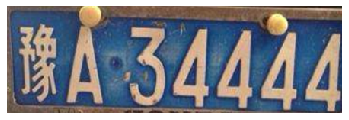

Result:  豫A90948
**************************************************
Target:  皖FZ777B


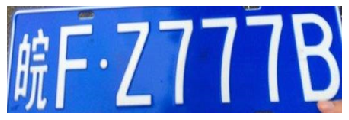

Result:  粤F21186
**************************************************
Target:  黑G10086


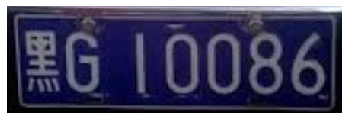

Result:  苏E16386
**************************************************
Target:  湘E00000


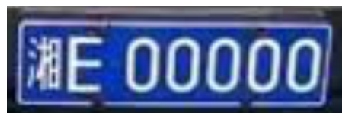

Result:  湘A00000
**************************************************
Target:  湘B99999


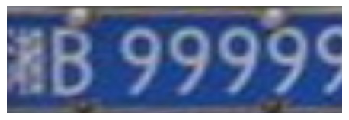

Result:  辽BV9998
**************************************************
Target:  粤A3Y347


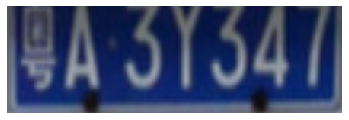

Result:  辽AS9785
**************************************************
Target:  宁AE1111


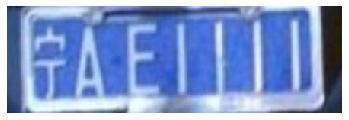

Result:  辽A91288
**************************************************
Target:  鄂AV6985


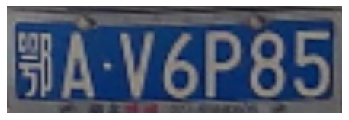

Result:  鄂A76985
**************************************************
Target:  川A99999


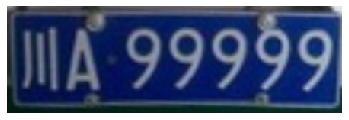

Result:  川A99999
**************************************************
Target:  贵Q00000


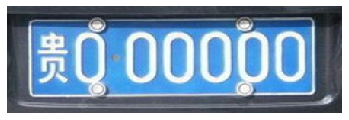

Result:  贵A00000
**************************************************
Target:  琼AM6666


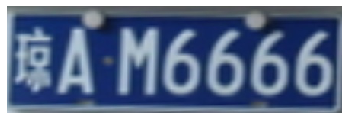

Result:  鄂A86666
**************************************************
Target:  粤A0U222


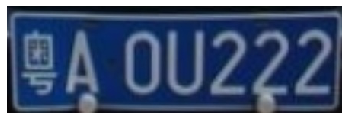

Result:  粤A00222
**************************************************
Target:  藏AJ8567


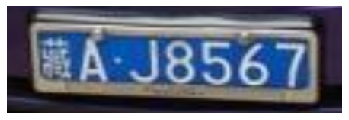

Result:  鄂BW8927
**************************************************
Target:  豫U88888


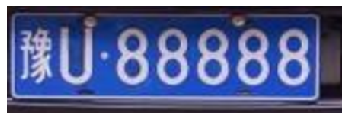

Result:  豫A88888
**************************************************
Target:  湘J99999


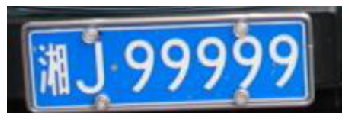

Result:  赣B19909
**************************************************
Target:  湘J88888


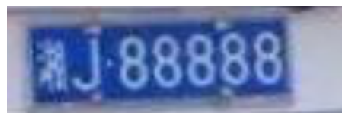

Result:  辽A98888
**************************************************
Target:  鄂AC8775


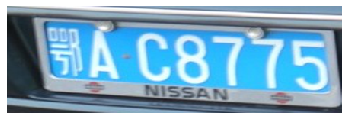

Result:  鄂A88765
**************************************************
Target:  青H77777


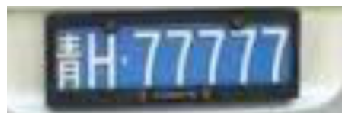

Result:  粤A77778
**************************************************
Target:  津CD0001


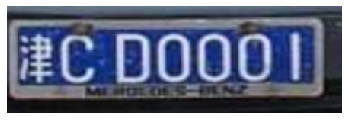

Result:  津A51188
**************************************************
Target:  陕B88888


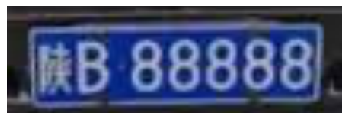

Result:  鄂B88888
**************************************************
Target:  京GT7777


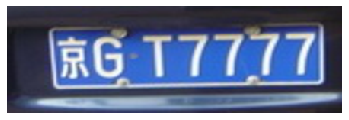

Result:  津AT7777
**************************************************
Target:  吉D12407


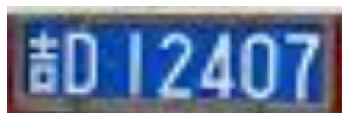

Result:  鄂F02006
**************************************************
Target:  苏AHC530


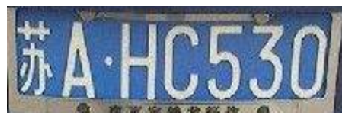

Result:  苏AH0568
**************************************************
Target:  桂AHQ055


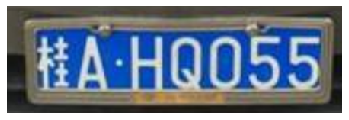

Result:  粤AH1218
**************************************************
Target:  冀A5942B


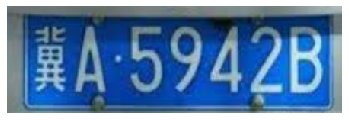

Result:  鄂A98198
**************************************************
Target:  粤B594SB


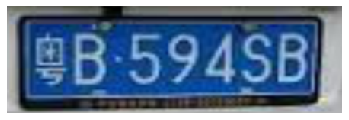

Result:  鄂A59188
**************************************************
Target:  鄂ABH181


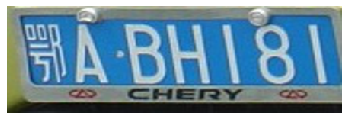

Result:  鄂A42188
**************************************************
Target:  豫D88888


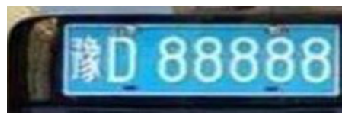

Result:  豫A88859
**************************************************
Target:  京A00005


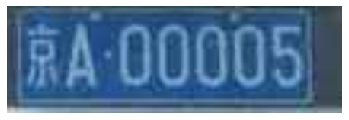

Result:  京A00005
**************************************************
Target:  冀D20000


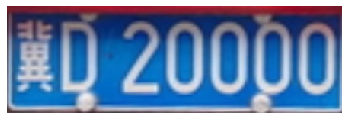

Result:  苏B80000
**************************************************
Target:  鄂DHY999


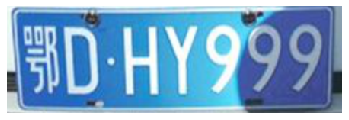

Result:  鄂B00000
**************************************************
Target:  浙H66666


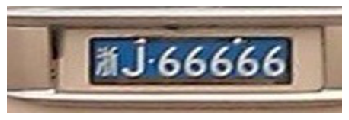

Result:  鄂A86866
**************************************************
Target:  粤X12345


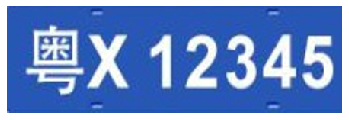

Result:  粤A72085
**************************************************
Target:  苏B77777


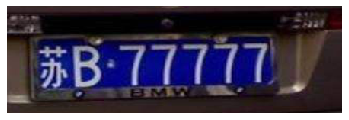

Result:  苏B18877
**************************************************
Target:  辽B5942B


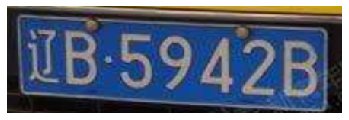

Result:  辽BA8008
**************************************************
Target:  津HSB555


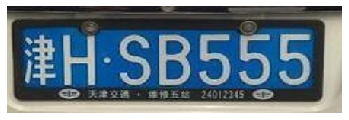

Result:  津A59596
**************************************************
Target:  宁AB5555


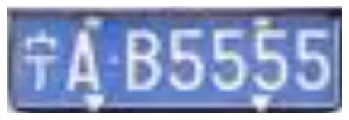

Result:  鲁A78085
**************************************************
Target:  陕B66666


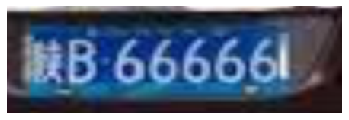

Result:  陕B02666
**************************************************
Target:  湘NA0000


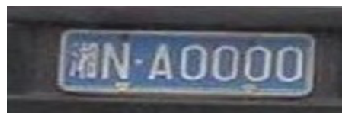

Result:  湘AA0000
**************************************************
Target:  皖B00001


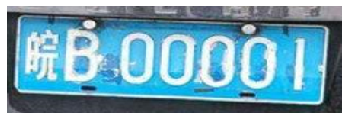

Result:  浙B00000
**************************************************
Target:  苏ESB748


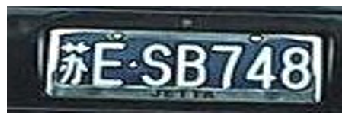

Result:  苏GS8188
**************************************************
Target:  苏MUIC26


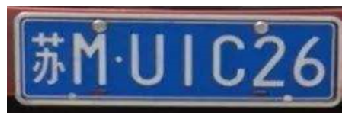

Result:  苏FU1118
**************************************************
Target:  辽BSM939


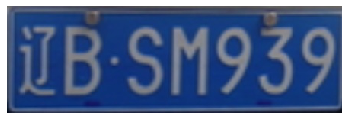

Result:  辽BS8999
**************************************************
Target:  桂B2R239


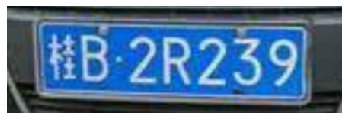

Result:  陕B08039
**************************************************
Target:  苏AMB936


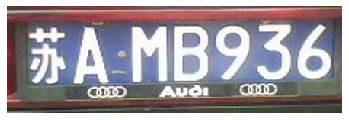

Result:  苏A98936
**************************************************
Target:  云A5D9Q2


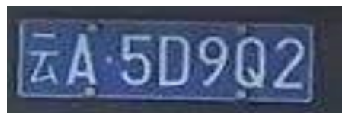

Result:  云A00006
**************************************************
Target:  桂L3B620


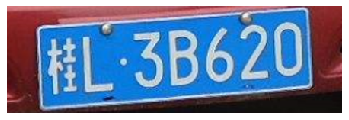

Result:  贵B18600
**************************************************
Target:  辽BD8800


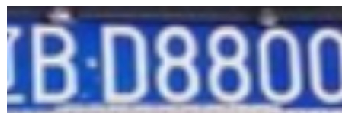

Result:  辽AD8868
**************************************************
Target:  京A88250


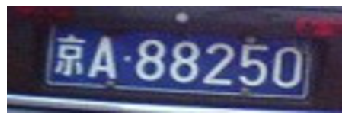

Result:  京A88760
**************************************************
Target:  粤K44444


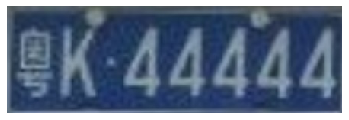

Result:  鄂A42185
**************************************************
Target:  蒙EEE430


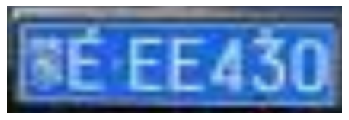

Result:  辽A78638
**************************************************
Target:  豫AAAAAA


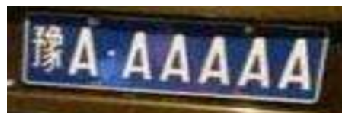

Result:  豫AA8766
**************************************************
Target:  鲁A44444


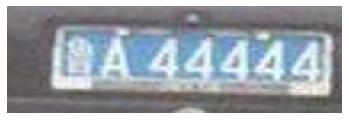

Result:  鲁A40048
**************************************************
Target:  贵CL5608


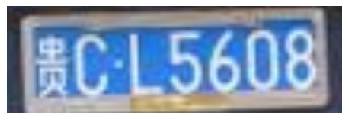

Result:  黑B85909
**************************************************
Target:  辽A22222


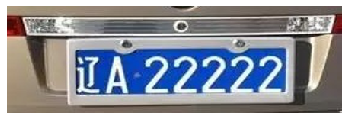

Result:  辽A22221
**************************************************
Target:  辽AQ6493


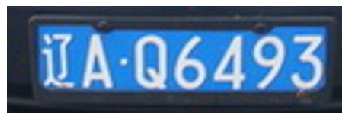

Result:  辽A86766
**************************************************
Target:  云K66666


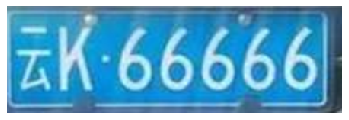

Result:  蒙A76666
**************************************************
Target:  赣D66666


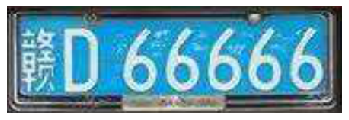

Result:  陕B06066
**************************************************
Target:  沪AJR001


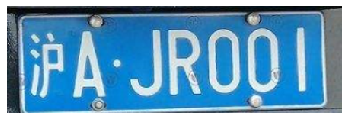

Result:  赣A80009
**************************************************
Target:  苏A925X2


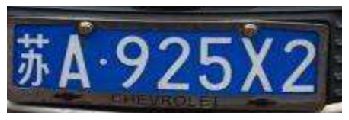

Result:  赣A52552
**************************************************
Target:  琼B09990


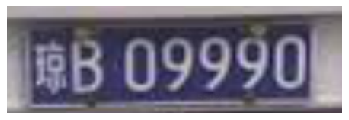

Result:  鄂AS9999
**************************************************
Target:  鄂E00001


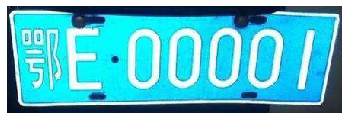

Result:  鄂D00000
**************************************************
Target:  京A34291


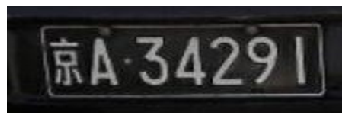

Result:  京A08761
**************************************************
Target:  桂K88888


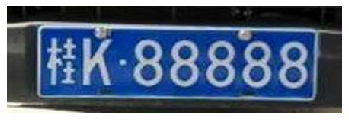

Result:  贵A88888
**************************************************
Target:  赣A88888


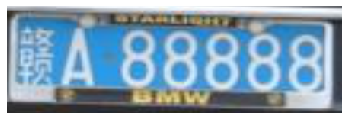

Result:  鄂A80888
**************************************************
Target:  鲁Q00666


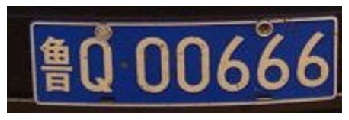

Result:  津A02666
**************************************************
Target:  浙B88888


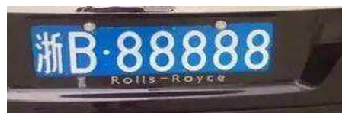

Result:  浙B89808
**************************************************
Target:  粤DV8888


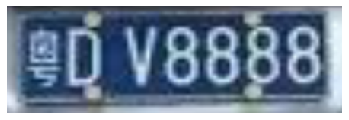

Result:  粤BV8888
**************************************************
Target:  闽D00169


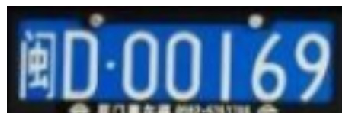

Result:  川A00869
**************************************************
Target:  蒙D33333


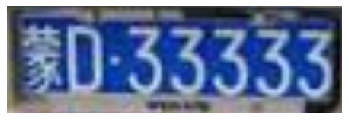

Result:  浙B86327
**************************************************
Target:  桂CXB066


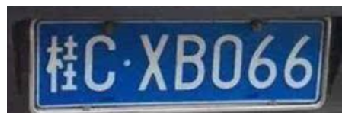

Result:  吉B08006
**************************************************
Target:  鄂F38533


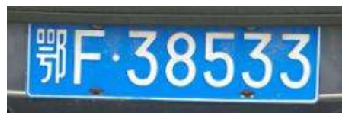

Result:  鄂A88530
**************************************************
Target:  鄂A7A777


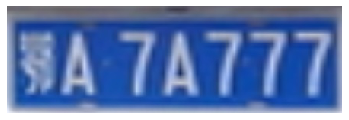

Result:  鄂A79188
**************************************************
Target:  川E22222


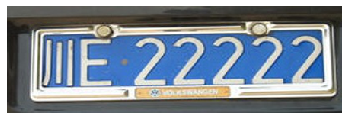

Result:  鄂A22228
**************************************************
Target:  辽B0516B


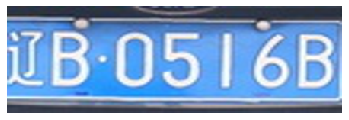

Result:  辽A09069
**************************************************
Target:  冀D00000


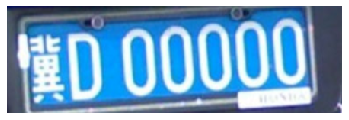

Result:  川A00000
**************************************************
Target:  渝AN7968


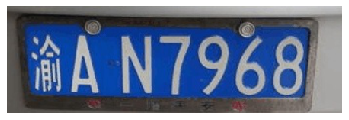

Result:  鄂AS6998
**************************************************
Target:  吉BU9999


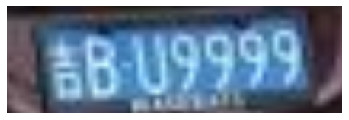

Result:  吉B00000
**************************************************
Target:  鲁C03456


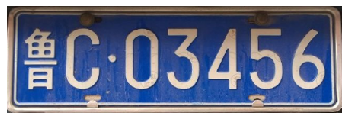

Result:  鄂B08880
**************************************************
Target:  陕C12345


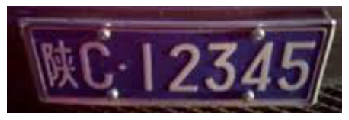

Result:  陕B12321
**************************************************
Target:  鲁A88888


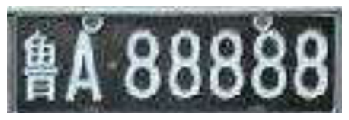

Result:  鲁A78888
**************************************************
Target:  闽F88888


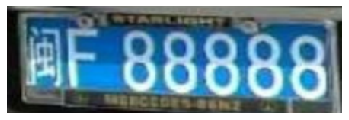

Result:  辽B08000
**************************************************
Target:  宁AK2222


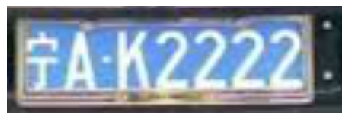

Result:  川A02022
**************************************************
Target:  冀A56789


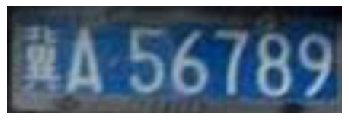

Result:  鄂A56789
**************************************************
Target:  川M11111


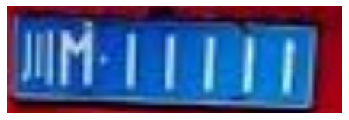

Result:  川B10801
**************************************************
Target:  赣B2B250


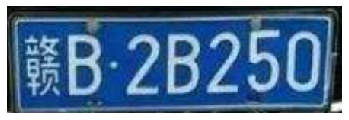

Result:  川B01250
**************************************************
Target:  鄂L0A000


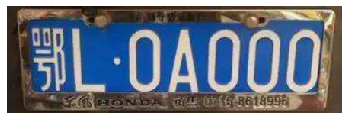

Result:  鄂B06080
**************************************************
Target:  鄂AA8532


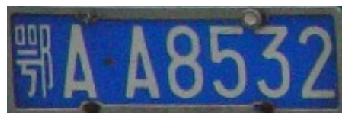

Result:  鄂AA8532
**************************************************
Target:  冀C88888


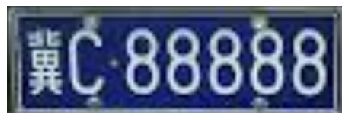

Result:  豫C88888
**************************************************
Target:  冀BJ2008


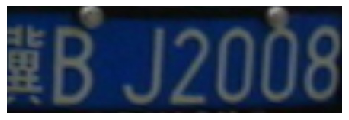

Result:  苏BW1181
**************************************************
Target:  京A88888


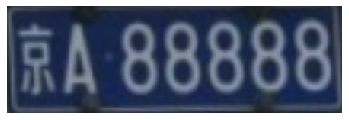

Result:  鄂A88080
**************************************************
Target:  晋A00000


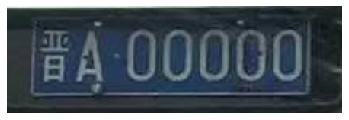

Result:  鄂A00000
**************************************************
Target:  吉D05555


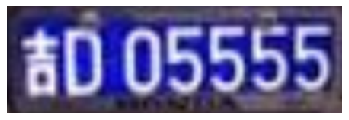

Result:  吉B05508
**************************************************
Target:  琼E34567


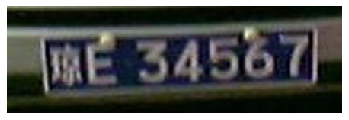

Result:  琼E11567
**************************************************
Target:  津JSB110


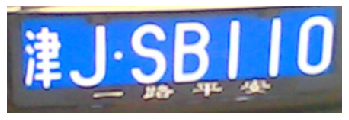

Result:  辽A76968
**************************************************
Target:  鲁G88888


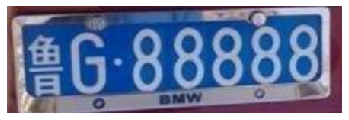

Result:  鲁A88888
**************************************************
Target:  鲁K88888


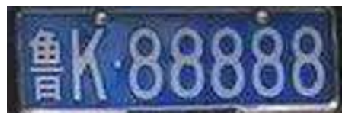

Result:  鄂A88888
**************************************************
Target:  晋A80390


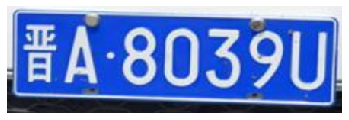

Result:  鲁A80880
**************************************************
Target:  鄂AP1661


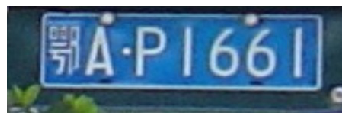

Result:  鄂AP6661
**************************************************
Target:  粤B66666


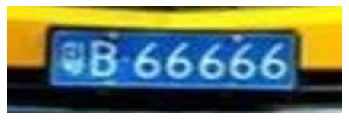

Result:  云A16661
**************************************************
Target:  粤A677WA


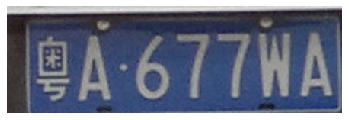

Result:  粤A77798
**************************************************
Target:  辽B777FX


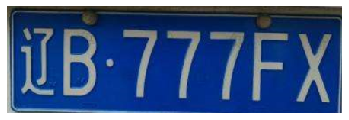

Result:  黑B71898
**************************************************
Target:  辽B9727C


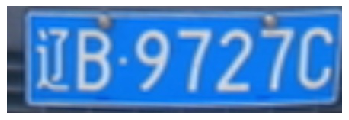

Result:  辽A90278
**************************************************
Target:  豫GVX888


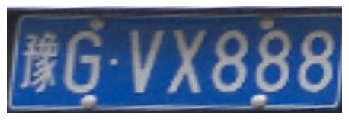

Result:  豫BA7888
**************************************************
Target:  辽B9979B


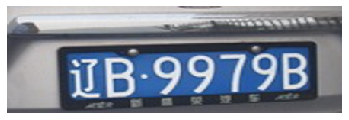

Result:  辽A96765
**************************************************
Target:  贵HK2906


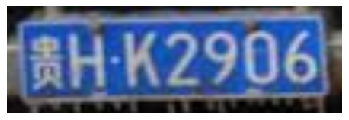

Result:  贵BW1907
**************************************************
Target:  鄂AN1366


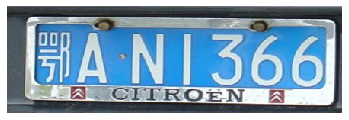

Result:  鄂AN1386
**************************************************
Target:  桂AVN999


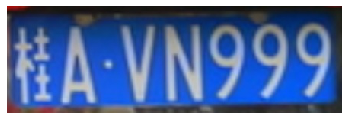

Result:  豫A50999
**************************************************
Target:  辽GLD666


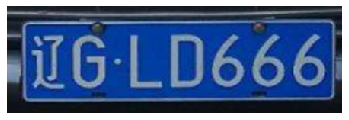

Result:  辽B08168
**************************************************
Target:  赣D00009


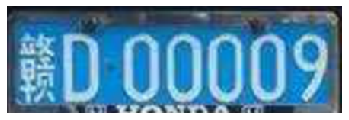

Result:  川A00009
**************************************************
Target:  藏AQ0000


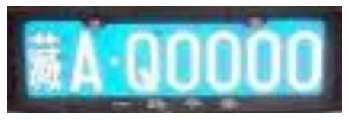

Result:  豫A10000
**************************************************
Target:  川W01666


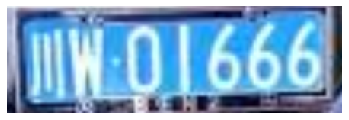

Result:  粤A21966
**************************************************
Target:  沪D99999


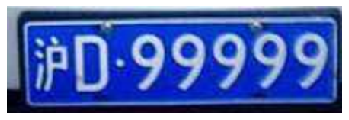

Result:  鄂A99998
**************************************************
Target:  蒙A88888


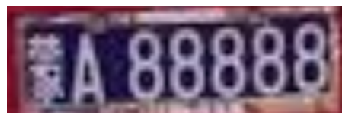

Result:  鄂A88888
**************************************************
Target:  晋AA886B


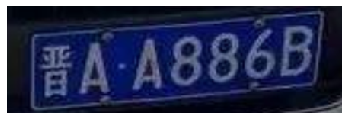

Result:  贵A18897
**************************************************
Target:  鲁Q01661


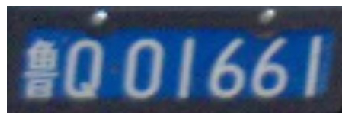

Result:  鲁A01662
**************************************************
Target:  蒙ADM878


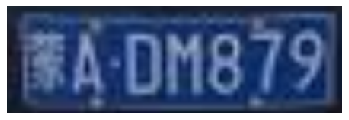

Result:  苏AD9898
**************************************************
Target:  黑B88888


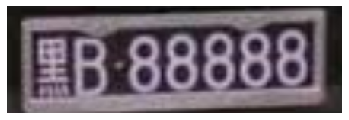

Result:  黑A88888
**************************************************
Target:  粤DS8888


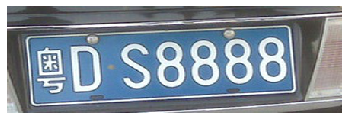

Result:  粤AS8888
**************************************************
Target:  津NGA511


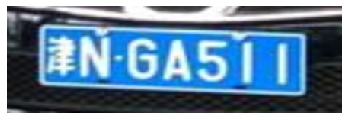

Result:  沪GP0601
**************************************************
Target:  冀A00001


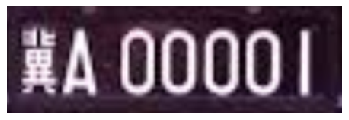

Result:  川A00000
**************************************************
Target:  豫A99999


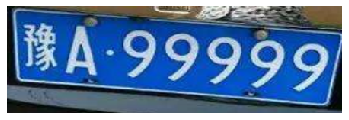

Result:  豫A59999
**************************************************
Target:  闽E2222J


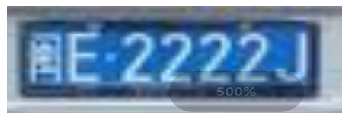

Result:  粤A22285
**************************************************
Target:  粤BB4920


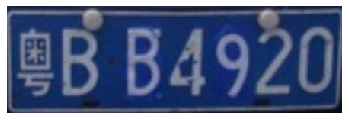

Result:  辽B01780
**************************************************
Target:  苏GB0000


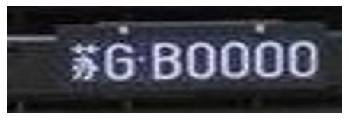

Result:  苏A00000
**************************************************
Target:  云GSB110


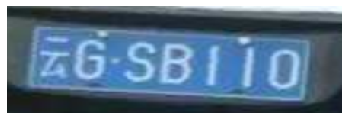

Result:  云G00000
**************************************************
Target:  陕M12291


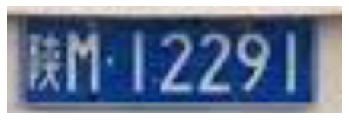

Result:  蒙L52899
**************************************************
Target:  苏EW5555


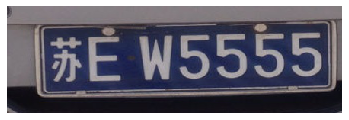

Result:  苏EW1505
**************************************************
Target:  津A55555


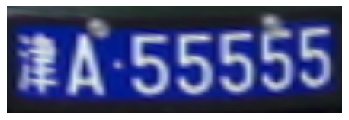

Result:  津A55558
**************************************************
Target:  湘J00002


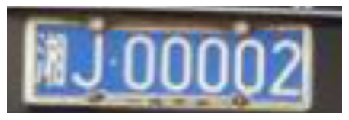

Result:  湘A00006
**************************************************
Target:  黑J88888


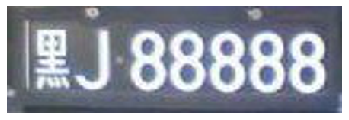

Result:  鄂A88888
**************************************************
Target:  贵ADR911


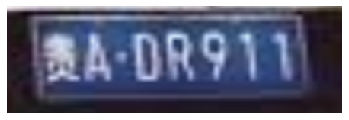

Result:  贵B81918
**************************************************
Target:  浙K5531S


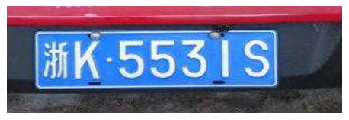

Result:  浙A55785
**************************************************
Target:  闽AK8888


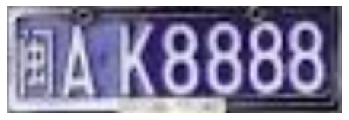

Result:  鄂A88888
**************************************************
Target:  陕CGD290


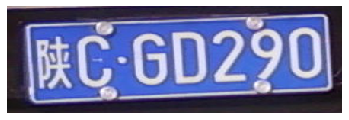

Result:  贵A91266
**************************************************
Target:  粤S11111


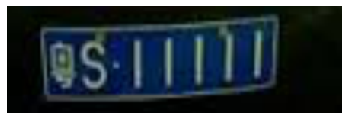

Result:  浙B11117
**************************************************
Target:  津AH7777


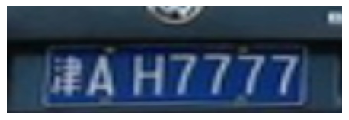

Result:  川A01899
**************************************************
Target:  苏MN210H


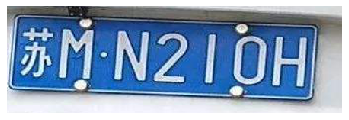

Result:  鄂A92198
**************************************************
Target:  粤CFM951


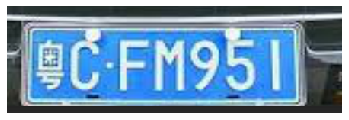

Result:  川F18951
**************************************************
Target:  蒙L88748


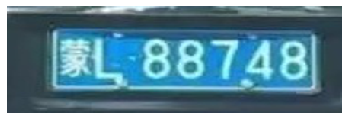

Result:  蒙L88768
**************************************************
Target:  渝D56789


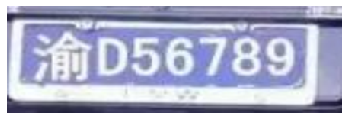

Result:  辽A25888
**************************************************
Target:  粤AG6666


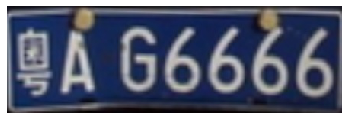

Result:  苏A06666
**************************************************
Target:  黑BSB156


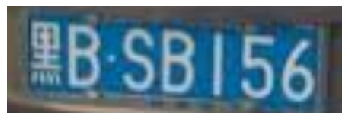

Result:  鄂B00006
**************************************************
Target:  琼A88888


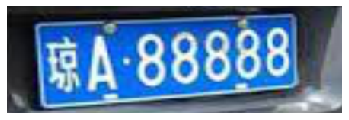

Result:  黑A88288
**************************************************
Target:  浙E55555


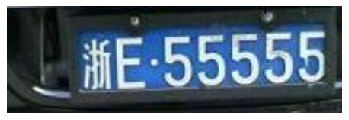

Result:  浙A58055
**************************************************
Target:  渝H11557


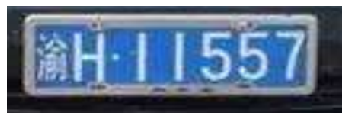

Result:  湘A11557
**************************************************
Target:  鄂AE0159


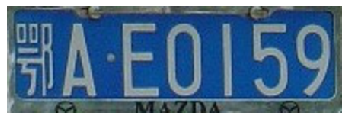

Result:  鄂A70188
**************************************************
Target:  豫SB2222


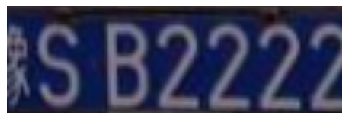

Result:  豫B82289
**************************************************
Target:  皖GC2269


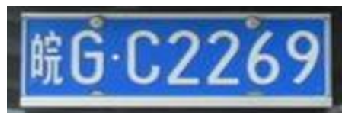

Result:  辽G52269
**************************************************
Target:  粤AKQ131


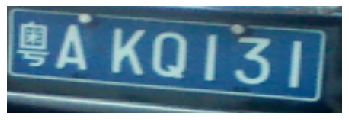

Result:  辽AS8138
**************************************************
Target:  黑BW8488


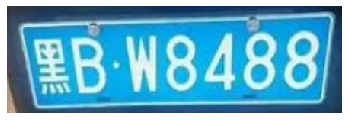

Result:  黑BW8988
**************************************************
Target:  贵GQ6666


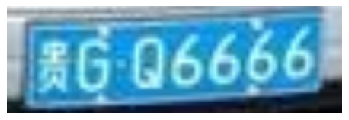

Result:  辽A96966
**************************************************
Target:  赣H95701


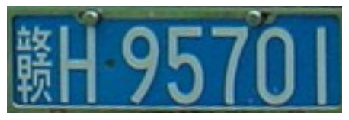

Result:  赣CV8009
**************************************************
Target:  晋AV6600


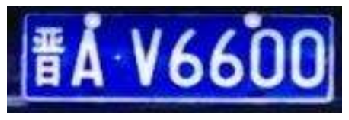

Result:  晋A88886
**************************************************
Target:  闽CD8888


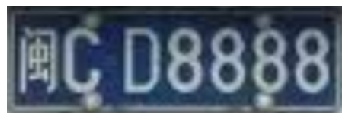

Result:  辽B58888
**************************************************
Target:  川C28888


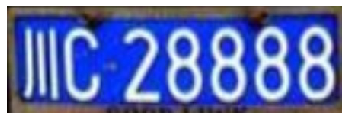

Result:  川B28888
**************************************************
Target:  宁AM4444


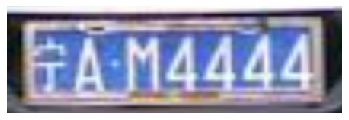

Result:  宁A06025
**************************************************
Target:  琼D00000


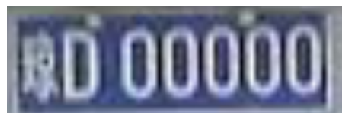

Result:  鄂A00000
**************************************************
Target:  云A526EG


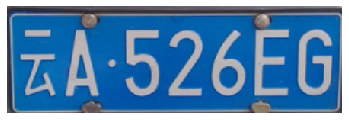

Result:  鄂AC8782
**************************************************
Target:  豫GPN677


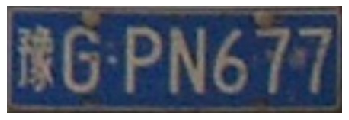

Result:  辽GP9785
**************************************************
Target:  鲁JD9309


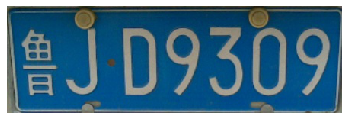

Result:  鲁A89302
**************************************************
Target:  皖A00595


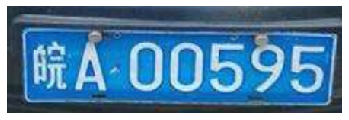

Result:  辽A00898
**************************************************
Target:  湘A99999


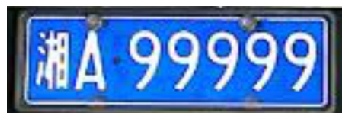

Result:  鄂A99998
**************************************************
Target:  陕AP0000


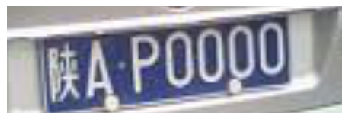

Result:  陕A00000
**************************************************
Target:  云AU7526


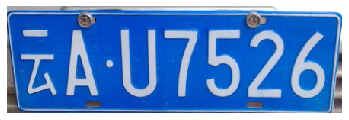

Result:  鲁AU5536
**************************************************
Target:  鄂A59770


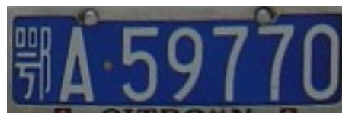

Result:  鄂A89780
**************************************************
Target:  宁B11111


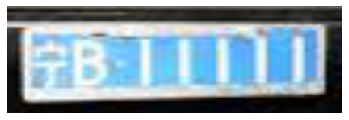

Result:  津B11561
**************************************************
Target:  晋E66666


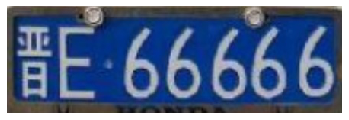

Result:  鄂A86666
**************************************************
Target:  苏DN1660


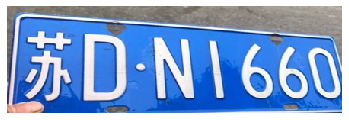

Result:  鄂A71666
**************************************************
Target:  沪FQ1277


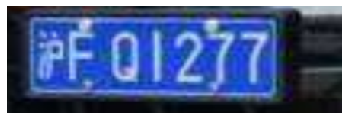

Result:  沪FU1277
**************************************************
Target:  粤A2Y222


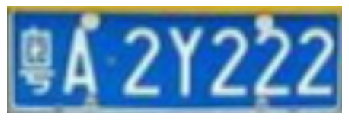

Result:  粤A29892
**************************************************
Target:  赣LK9999


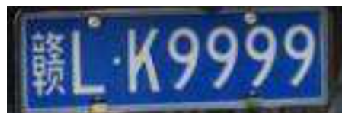

Result:  赣B82989
**************************************************
Target:  黑L99999


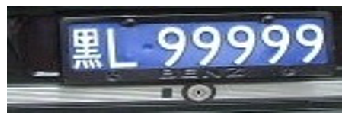

Result:  浙A59959
**************************************************
Target:  川S77777


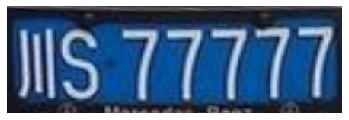

Result:  浙B87818
**************************************************
Target:  鲁T00539


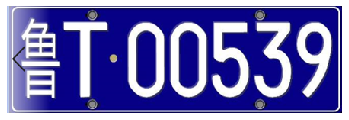

Result:  鲁A00858
**************************************************
Target:  辽BB5111


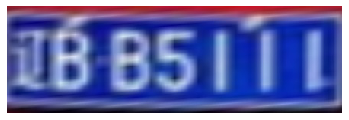

Result:  鄂B89186
**************************************************
Target:  鄂K9M555


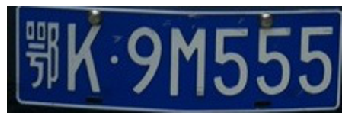

Result:  鄂B88500
**************************************************
Target:  宁EC2222


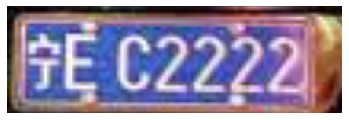

Result:  辽G52229
**************************************************
Target:  赣AP9562


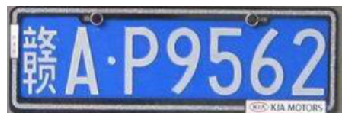

Result:  鲁AP9062
**************************************************
Target:  宁ET6003


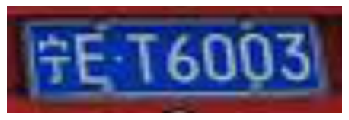

Result:  贵AH9236
**************************************************
Target:  琼EU6688


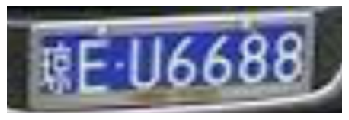

Result:  豫B06267
**************************************************
Target:  京AG6096


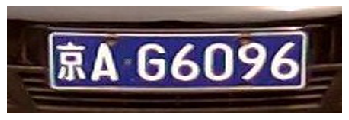

Result:  浙BU6807
**************************************************
Target:  京N1A882


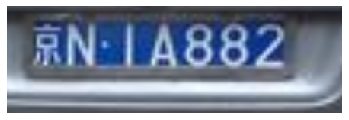

Result:  贵B50909


In [7]:
file_names = os.listdir(pic_dir)

for file_name in file_names:
    with Image.open(pic_dir + file_name).convert('L').resize((440, 140),Image.BICUBIC) as img:
        print("**************************************************")
        print("Target: ", file_name[:7])
        with Image.open(pic_dir + file_name).convert('RGB').resize((440, 140),Image.BICUBIC) as im:
            plt.figure()
            plt.imshow(im)
            plt.axis('off')
            plt.show()
        img = transforms.Compose([
                            transforms.ToTensor(),
                            ])(img).type(torch.FloatTensor).unsqueeze(0)
#         print(img.shape)
        model.eval()
        province_feature, license_feature = model(img)
        result = province_lst[torch.max(province_feature, 1)[1].data[0].numpy()]
        for i in range(6):
            result += char_lst[torch.max(license_feature[:,i], 1)[1].data[0].numpy()]
        print('Result: ', result)